<a href="https://colab.research.google.com/github/UritiSrikanth/Blood-Cells-Cancer-detection-using-CNN/blob/main/Preprocessing_of_the_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Importing Libraries**

In [14]:
import os
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import os
from PIL import Image
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import os
import matplotlib.pyplot as plt
from PIL import Image
import random
import numpy as np
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from skimage.feature import local_binary_pattern
from PIL import Image

**Display samples from the dataset**

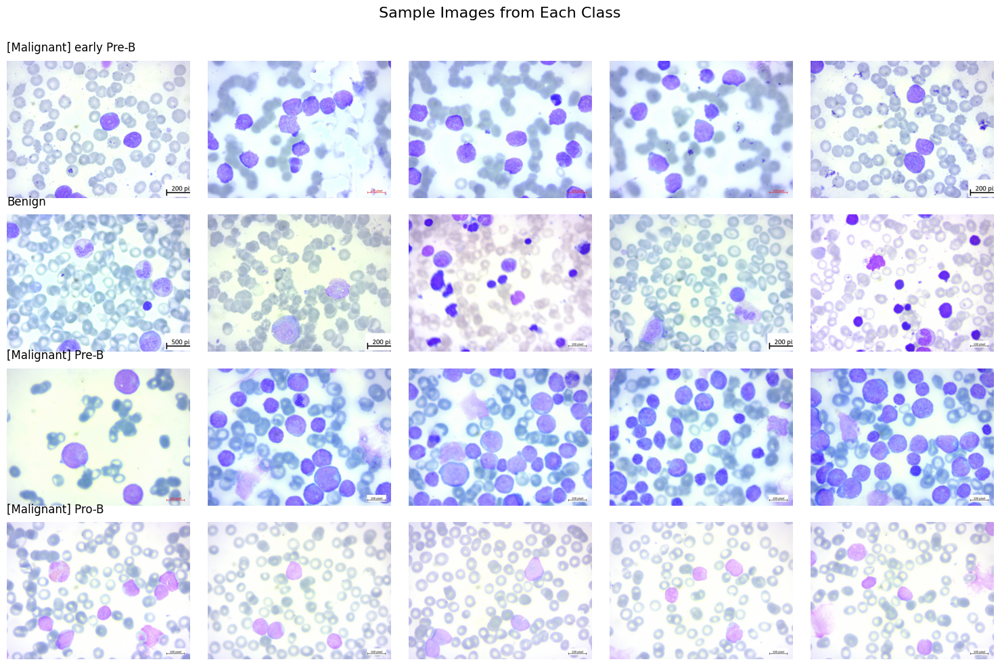

In [15]:
# Dataset folder path
dataset_path = "/content/drive/MyDrive/Blood cell Cancer [ALL]"

# Number of samples to display per class
samples_per_class = 5

# Create a figure for displaying the images
plt.figure(figsize=(15, 10))

# Loop through each class and display sample images
class_names = os.listdir(dataset_path)
for i, class_name in enumerate(class_names):
    class_folder = os.path.join(dataset_path, class_name)
    if os.path.isdir(class_folder):
        # Get a list of images in the class folder
        image_files = os.listdir(class_folder)

        # Randomly select a subset of images from the class
        sample_images = random.sample(image_files, min(samples_per_class, len(image_files)))

        # Loop through each selected image and display it
        for j, image_name in enumerate(sample_images):
            image_path = os.path.join(class_folder, image_name)
            try:
                # Open and display the image
                img = Image.open(image_path)
                ax = plt.subplot(len(class_names), samples_per_class, i * samples_per_class + j + 1)
                plt.imshow(img)
                plt.axis('off')

                # Add title for each class at the top of the first image in each row
                if j == 0:
                    ax.set_title(class_name, loc='left', fontsize=12, pad=10)
            except Exception as e:
                print(f"Error loading image {image_path}: {e}")

plt.suptitle("Sample Images from Each Class", fontsize=16)
plt.tight_layout()
plt.subplots_adjust(top=0.9)
plt.show()

**Class Distribution**

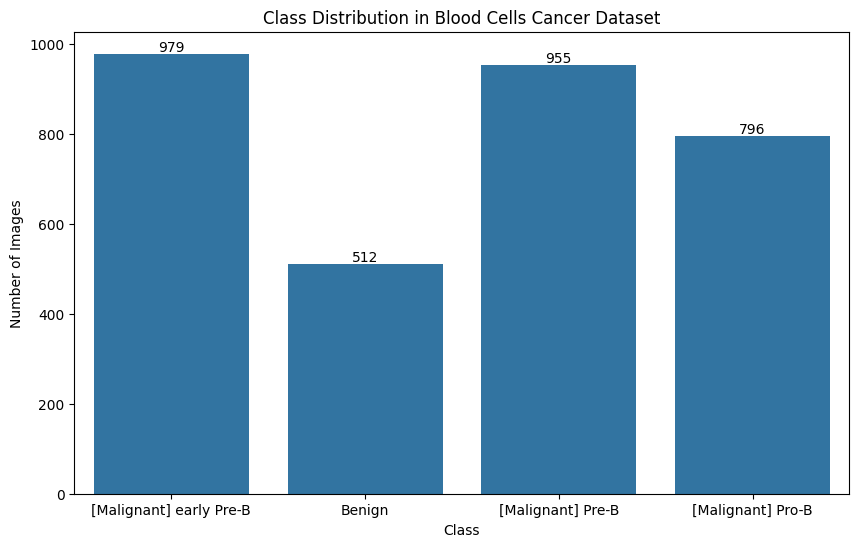

In [16]:
# Get class names and count the number of images in each class folder
class_counts = {}
for class_name in os.listdir(dataset_path):
    class_folder = os.path.join(dataset_path, class_name)
    if os.path.isdir(class_folder):
        class_counts[class_name] = len(os.listdir(class_folder))

# Convert the counts to a DataFrame for easy plotting
df_class_counts = pd.DataFrame(list(class_counts.items()), columns=['Class', 'Image Count'])

# Plotting the class distribution using Seaborn
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='Class', y='Image Count', data=df_class_counts)
plt.title("Class Distribution in Blood Cells Cancer Dataset")
plt.xlabel("Class")
plt.ylabel("Number of Images")

# Annotate each bar with the image count
for index, row in df_class_counts.iterrows():
    ax.text(index, row['Image Count'] + 5, row['Image Count'], color='black', ha="center")

plt.show()


**Checking for image properties: Height and Width for the images in each class**

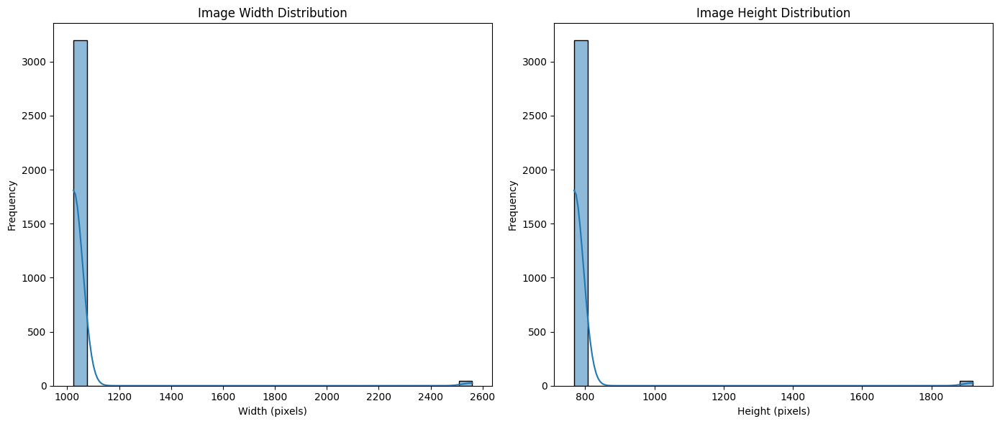

In [17]:
# List to store image properties
image_properties = []

# Iterate over each class folder
for class_name in os.listdir(dataset_path):
    class_folder = os.path.join(dataset_path, class_name)
    if os.path.isdir(class_folder):
        # Iterate over each image in the class folder
        for image_name in os.listdir(class_folder):
            image_path = os.path.join(class_folder, image_name)
            try:
                # Open image and get its size
                with Image.open(image_path) as img:
                    width, height = img.size
                    # Ignore images with 2600 x 2600 dimensions
                    if width == 2600 and height == 2600:
                        continue
                    image_properties.append({
                        'Class': class_name,
                        'Width': width,
                        'Height': height
                    })
            except Exception as e:
                print(f"Error processing image {image_path}: {e}")

# Convert to DataFrame for easy analysis
df_image_properties = pd.DataFrame(image_properties)

# Plotting image width and height histograms
plt.figure(figsize=(14, 6))

# Plot width histogram
plt.subplot(1, 2, 1)
sns.histplot(df_image_properties['Width'], bins=30, kde=True)
plt.title("Image Width Distribution")
plt.xlabel("Width (pixels)")
plt.ylabel("Frequency")

# Plot height histogram
plt.subplot(1, 2, 2)
sns.histplot(df_image_properties['Height'], bins=30, kde=True)
plt.title("Image Height Distribution")
plt.xlabel("Height (pixels)")
plt.ylabel("Frequency")

plt.tight_layout()
plt.show()


In [18]:
df_image_properties

,Class,Width,Height
0,[Malignant] early Pre-B,1024,768
1,[Malignant] early Pre-B,1024,768
2,[Malignant] early Pre-B,1024,768
3,[Malignant] early Pre-B,1024,768
4,[Malignant] early Pre-B,1024,768
...,...,...,...
3237,[Malignant] Pro-B,1024,768
3238,[Malignant] Pro-B,1024,768
3239,[Malignant] Pro-B,1024,768
3240,[Malignant] Pro-B,1024,768


**Pixel intensity of each class**

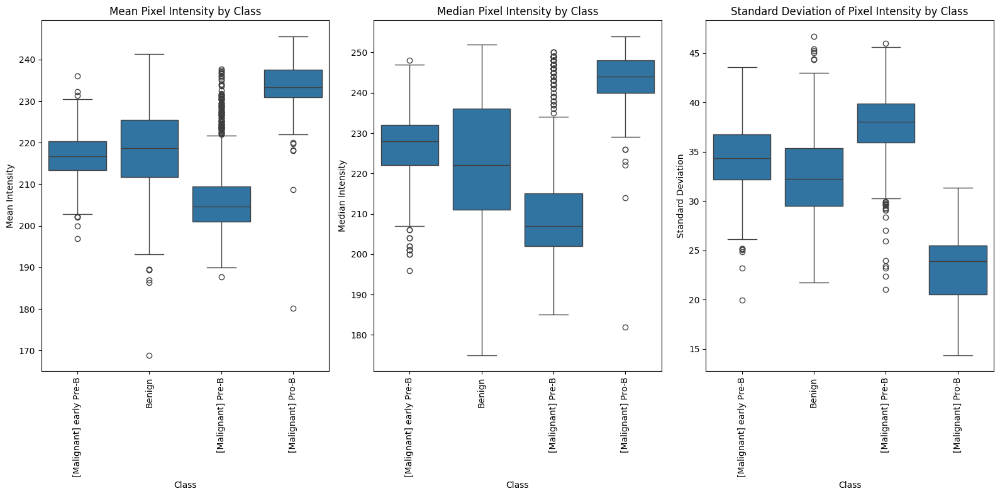

In [19]:
# List to store intensity statistics for each image
intensity_stats = []

# Iterate over each class folder
for class_name in os.listdir(dataset_path):
    class_folder = os.path.join(dataset_path, class_name)
    if os.path.isdir(class_folder):
        # Iterate over each image in the class folder
        for image_name in os.listdir(class_folder):
            image_path = os.path.join(class_folder, image_name)
            try:
                # Open image, convert to grayscale, and get pixel intensities
                with Image.open(image_path) as img:
                    img_gray = img.convert("L")  # Convert to grayscale
                    pixel_values = np.array(img_gray).flatten()  # Flatten to 1D array

                    # Calculate statistics
                    mean_intensity = np.mean(pixel_values)
                    median_intensity = np.median(pixel_values)
                    std_intensity = np.std(pixel_values)

                    # Store the statistics along with the class name
                    intensity_stats.append({
                        'Class': class_name,
                        'Mean Intensity': mean_intensity,
                        'Median Intensity': median_intensity,
                        'Standard Deviation': std_intensity
                    })
            except Exception as e:
                print(f"Error processing image {image_path}: {e}")

# Convert the statistics to a DataFrame for easy analysis
df_intensity_stats = pd.DataFrame(intensity_stats)

# Plotting mean, median, and standard deviation of pixel intensity by class
plt.figure(figsize=(16, 8))

# Mean Intensity
plt.subplot(1, 3, 1)
sns.boxplot(x='Class', y='Mean Intensity', data=df_intensity_stats)
plt.xticks(rotation=90)
plt.title("Mean Pixel Intensity by Class")

# Median Intensity
plt.subplot(1, 3, 2)
sns.boxplot(x='Class', y='Median Intensity', data=df_intensity_stats)
plt.xticks(rotation=90)
plt.title("Median Pixel Intensity by Class")

# Standard Deviation of Intensity
plt.subplot(1, 3, 3)
sns.boxplot(x='Class', y='Standard Deviation', data=df_intensity_stats)
plt.xticks(rotation=90)
plt.title("Standard Deviation of Pixel Intensity by Class")

plt.tight_layout()
plt.show()

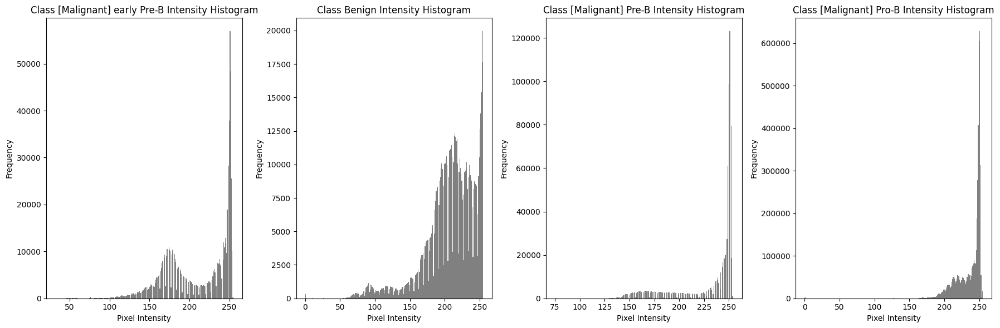

In [20]:
# Sample images for intensity histogram analysis
sample_images = [os.path.join(dataset_path, class_folder, os.listdir(os.path.join(dataset_path, class_folder))[0])
                 for class_folder in os.listdir(dataset_path) if os.path.isdir(os.path.join(dataset_path, class_folder))]

plt.figure(figsize=(18, 6))
for i, image_path in enumerate(sample_images):
    with Image.open(image_path) as img:
        img_gray = np.array(img.convert("L"))
        plt.subplot(1, len(sample_images), i + 1)
        plt.hist(img_gray.ravel(), bins=256, color='gray')
        plt.title(f"Class {os.path.basename(os.path.dirname(image_path))} Intensity Histogram")
        plt.xlabel("Pixel Intensity")
        plt.ylabel("Frequency")
plt.tight_layout()
plt.show()


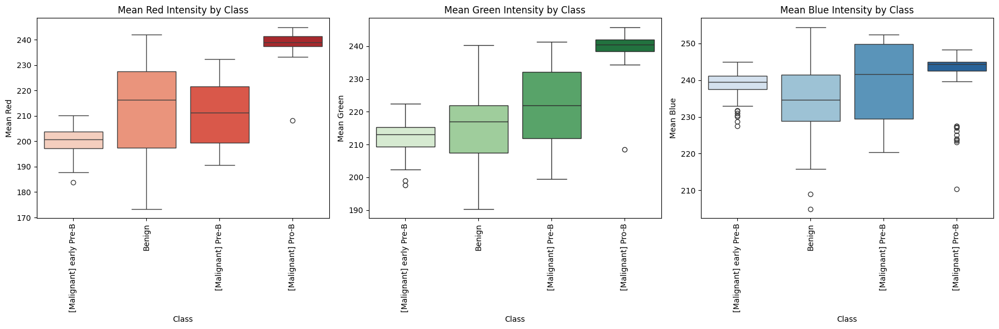

In [21]:
# List to store color channel statistics for each image
color_channel_stats = []

# Iterate over each class folder
for class_name in os.listdir(dataset_path):
    class_folder = os.path.join(dataset_path, class_name)
    if os.path.isdir(class_folder):
        # Iterate over a subset of images in the class folder to limit processing time
        for image_name in os.listdir(class_folder)[:100]:  # Limiting to first 100 images per class
            image_path = os.path.join(class_folder, image_name)
            try:
                # Open image and get pixel values for each color channel
                with Image.open(image_path) as img:
                    img_rgb = img.convert("RGB")  # Ensure the image is in RGB format
                    r, g, b = img_rgb.split()     # Split into Red, Green, Blue channels

                    # Calculate mean values for each channel
                    mean_r = np.mean(np.array(r))
                    mean_g = np.mean(np.array(g))
                    mean_b = np.mean(np.array(b))

                    # Store the mean color values along with the class name
                    color_channel_stats.append({
                        'Class': class_name,
                        'Mean Red': mean_r,
                        'Mean Green': mean_g,
                        'Mean Blue': mean_b
                    })
            except Exception as e:
                print(f"Error processing image {image_path}: {e}")

# Convert to DataFrame for easy analysis
df_color_channel_stats = pd.DataFrame(color_channel_stats)

# Plotting mean color intensities for each channel by class
plt.figure(figsize=(18, 6))

# Mean Red Intensity
plt.subplot(1, 3, 1)
sns.boxplot(x='Class', y='Mean Red', data=df_color_channel_stats, hue='Class', palette="Reds", legend=False)
plt.xticks(rotation=90)
plt.title("Mean Red Intensity by Class")

# Mean Green Intensity
plt.subplot(1, 3, 2)
sns.boxplot(x='Class', y='Mean Green', data=df_color_channel_stats, hue='Class', palette="Greens", legend=False)
plt.xticks(rotation=90)
plt.title("Mean Green Intensity by Class")

# Mean Blue Intensity
plt.subplot(1, 3, 3)
sns.boxplot(x='Class', y='Mean Blue', data=df_color_channel_stats, hue='Class', palette="Blues", legend=False)
plt.xticks(rotation=90)
plt.title("Mean Blue Intensity by Class")

plt.tight_layout()
plt.show()


**PCA analysis**

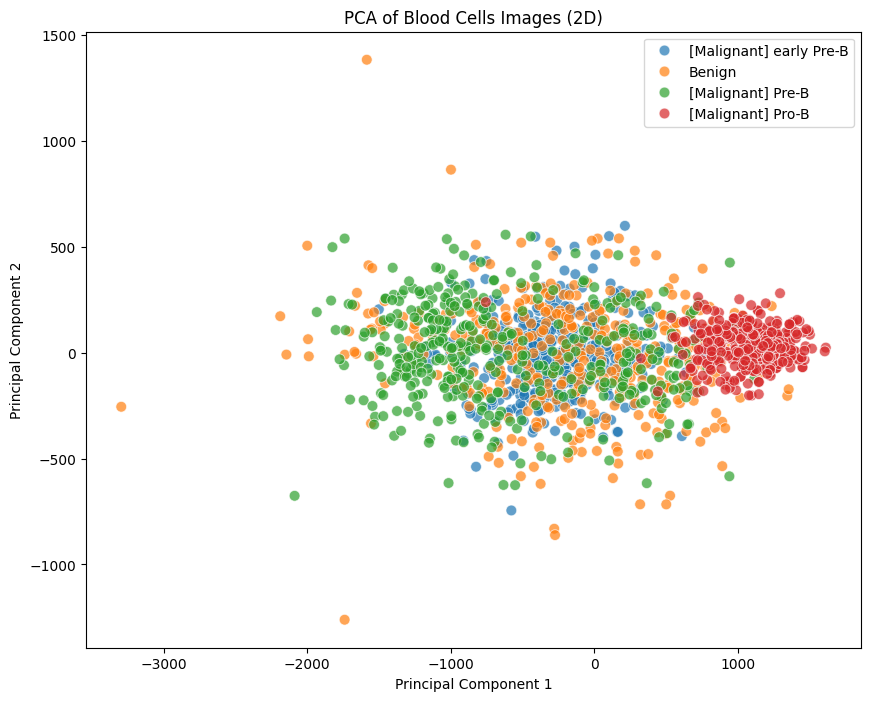

In [22]:
from sklearn.decomposition import PCA
# Parameters
num_images_per_class = 400  # Limit number of images per class for faster processing
image_size = (64, 64)  # Resize images to a fixed size for PCA

# Lists to store flattened images and their labels
flattened_images = []
labels = []

# Load and process images
for class_name in os.listdir(dataset_path):
    class_folder = os.path.join(dataset_path, class_name)
    if os.path.isdir(class_folder):
        # Limit to a subset of images per class
        for image_name in os.listdir(class_folder)[:num_images_per_class]:
            image_path = os.path.join(class_folder, image_name)
            try:
                with Image.open(image_path) as img:
                    # Convert image to grayscale and resize
                    img_gray = img.convert("L").resize(image_size)
                    # Flatten the image and add to list
                    flattened_images.append(np.array(img_gray).flatten())
                    labels.append(class_name)
            except Exception as e:
                print(f"Error processing image {image_path}: {e}")

# Convert to numpy arrays
flattened_images = np.array(flattened_images)
labels = np.array(labels)

# Apply PCA to reduce dimensions
pca = PCA(n_components=3)
pca_result = pca.fit_transform(flattened_images)

# Create a DataFrame for easier plotting
df_pca = pd.DataFrame(pca_result, columns=['PC1', 'PC2', 'PC3'])
df_pca['Class'] = labels

# 2D Plot (PC1 vs PC2)
plt.figure(figsize=(10, 8))
sns.scatterplot(data=df_pca, x='PC1', y='PC2', hue='Class', alpha=0.7, s=60)
plt.title("PCA of Blood Cells Images (2D)")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.legend()
plt.show()


In [23]:
from skimage.filters.rank import entropy
from skimage.morphology import disk
from skimage.color import rgb2gray
import warnings
import random
warnings.filterwarnings("ignore")

**Data preprocessing: Entropy Filtering**

In [24]:
# Function to apply entropy filtering with a given disk radius
def apply_entropy_filtering(image, radius):
    gray_image = rgb2gray(image)  # Convert to grayscale
    entropy_image = entropy(gray_image, disk(radius))  # Compute entropy with specified radius
    return entropy_image

**Hyper parameter tuning for Entropy Filtering**

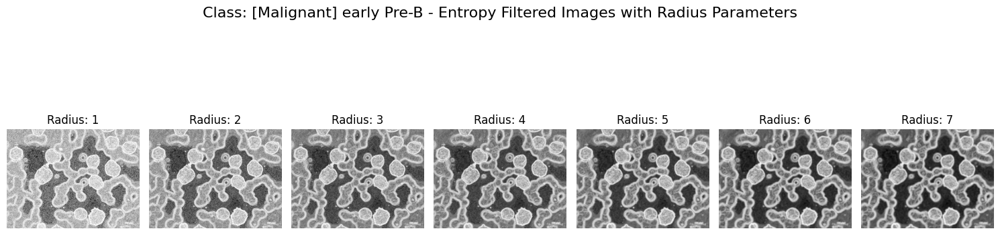

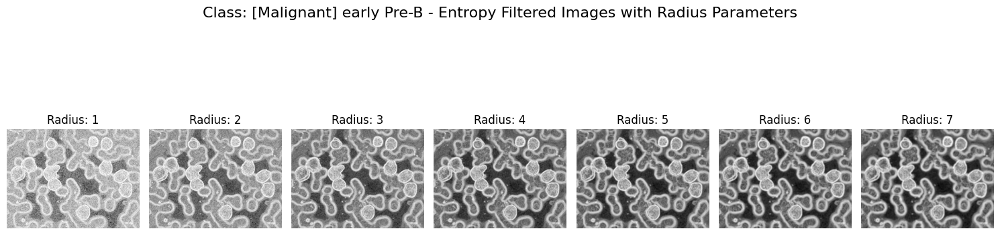

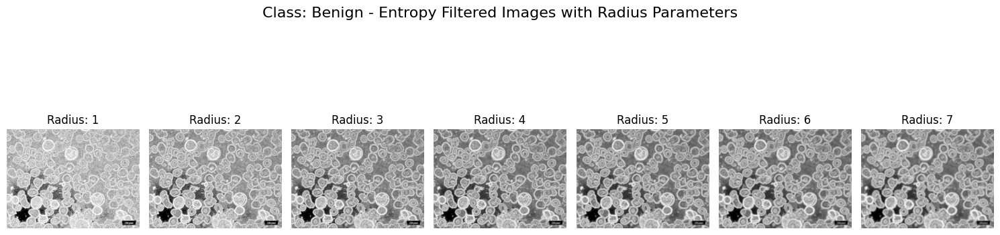

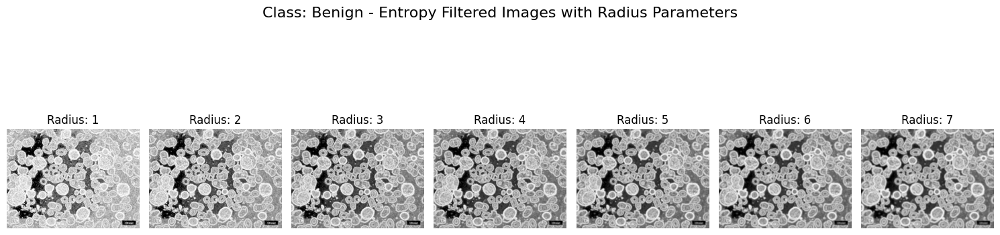

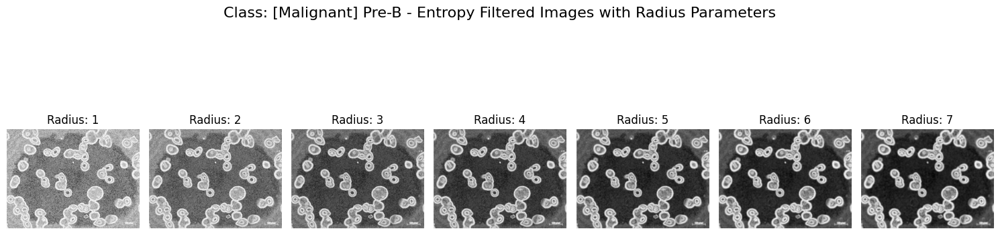

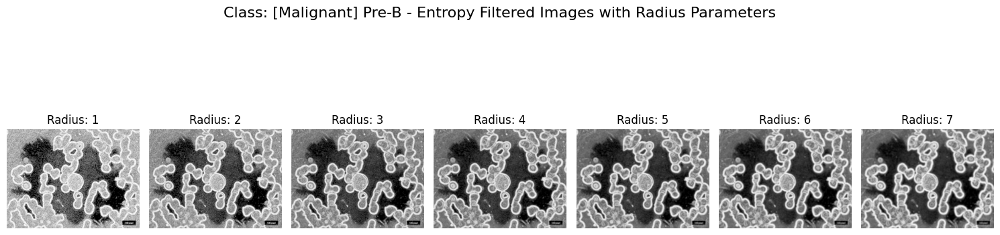

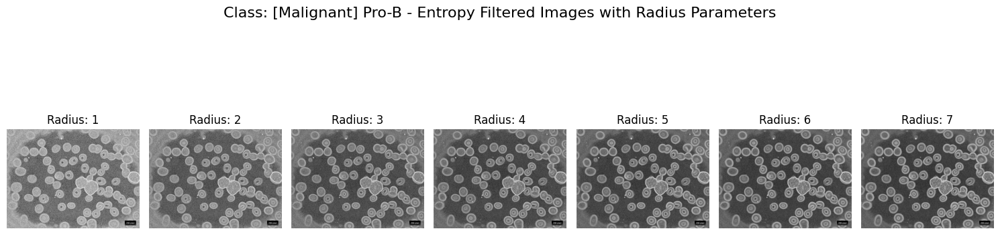

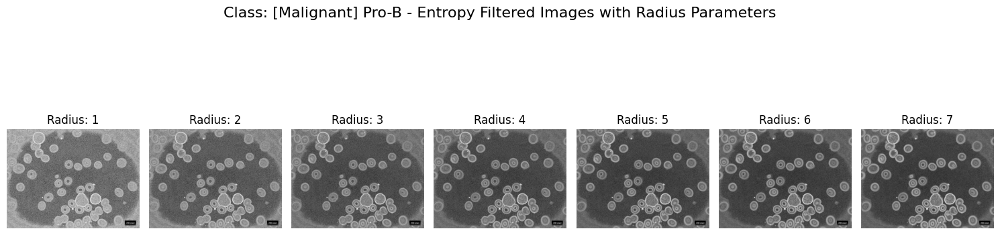

In [25]:
# Get the class folders
classes = [folder for folder in os.listdir(dataset_path) if os.path.isdir(os.path.join(dataset_path, folder))]


# Radii for hyperparameter tuning
radii = [1,2,3,4, 5,6,7]

#  visualization to display only preprocessed images
for cls in classes:
    class_path = os.path.join(dataset_path, cls)
    images = [os.path.join(class_path, img) for img in os.listdir(class_path) if img.endswith(('png', 'jpg', 'jpeg'))]

    # Select 2 images from each class for hyperparameter tuning visualization
    selected_images = images[:2]

    for img_path in selected_images:
        # Read the image
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        fig, axes = plt.subplots(1, len(radii), figsize=(15, 5))
        fig.suptitle(f'Class: {cls} - Entropy Filtered Images with Radius Parameters', fontsize=16)

        # Plot entropy filtered images for each radius
        for j, radius in enumerate(radii):
            filtered_image = apply_entropy_filtering(image, radius)
            axes[j].imshow(filtered_image, cmap='gray')
            axes[j].set_title(f'Radius: {radius}')
            axes[j].axis('off')

        plt.tight_layout()
        plt.show()

**Displaying image with the selected parameter**

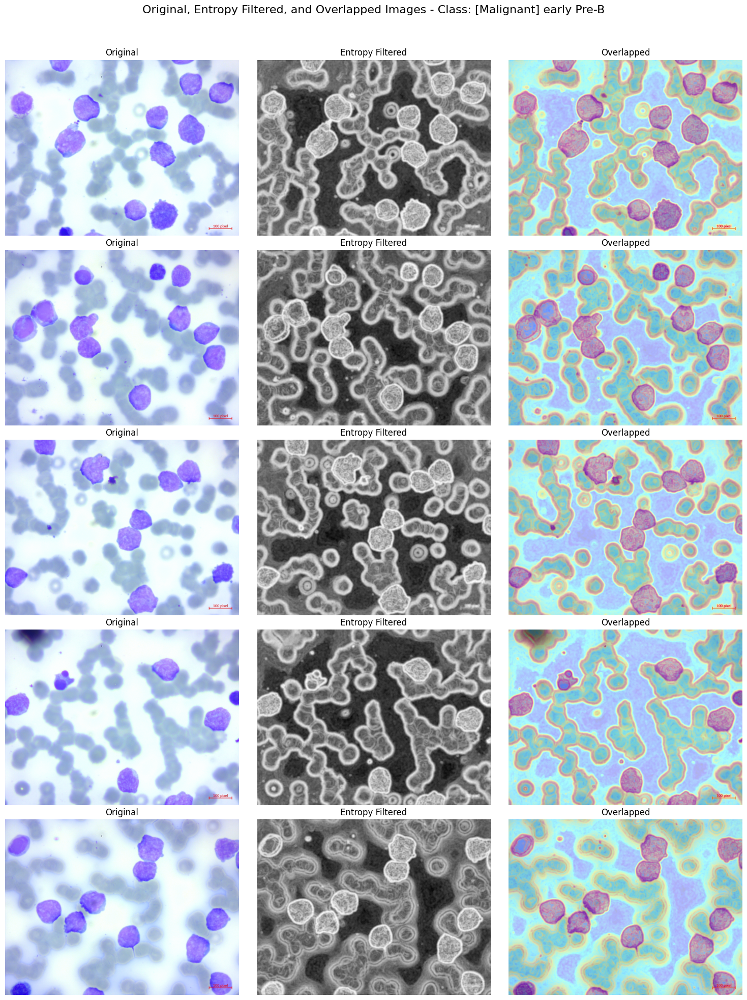

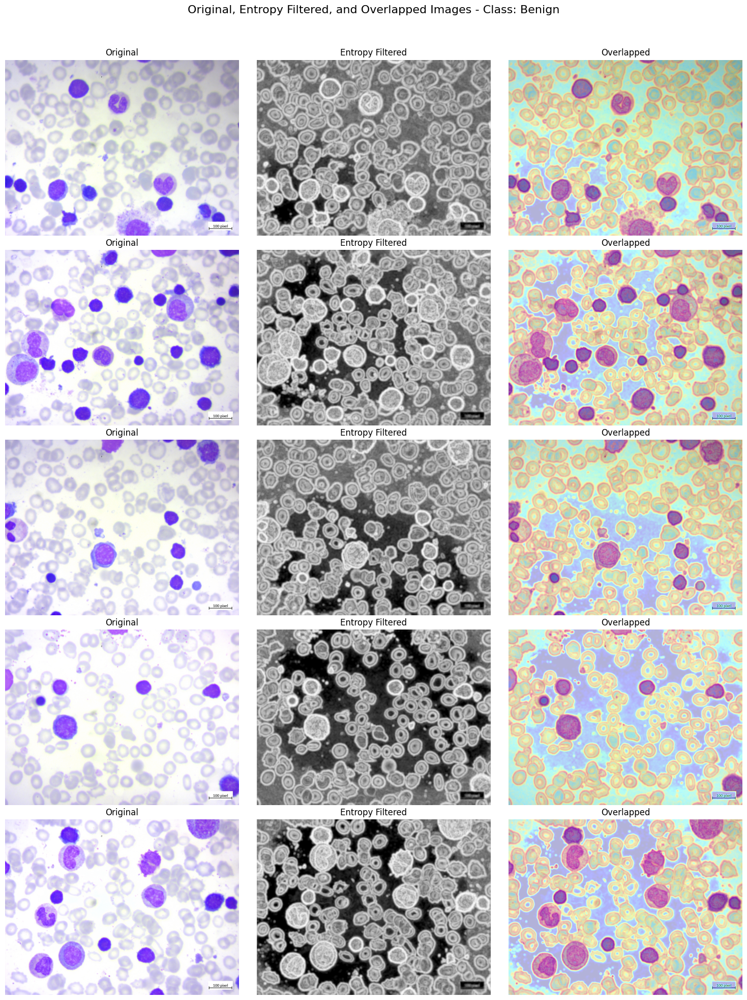

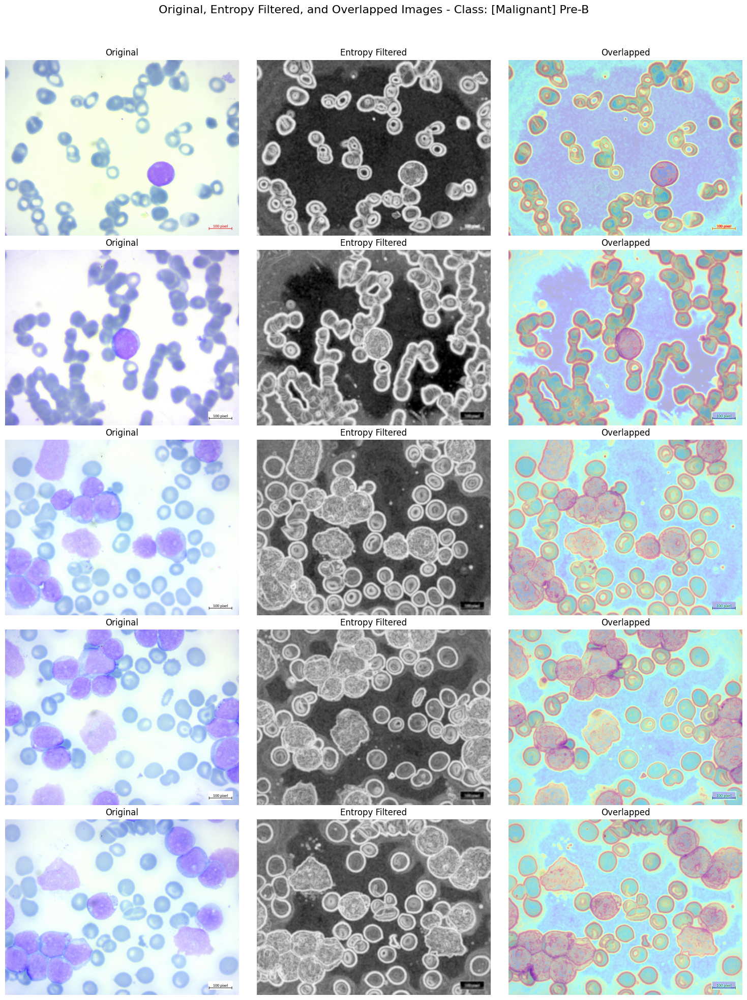

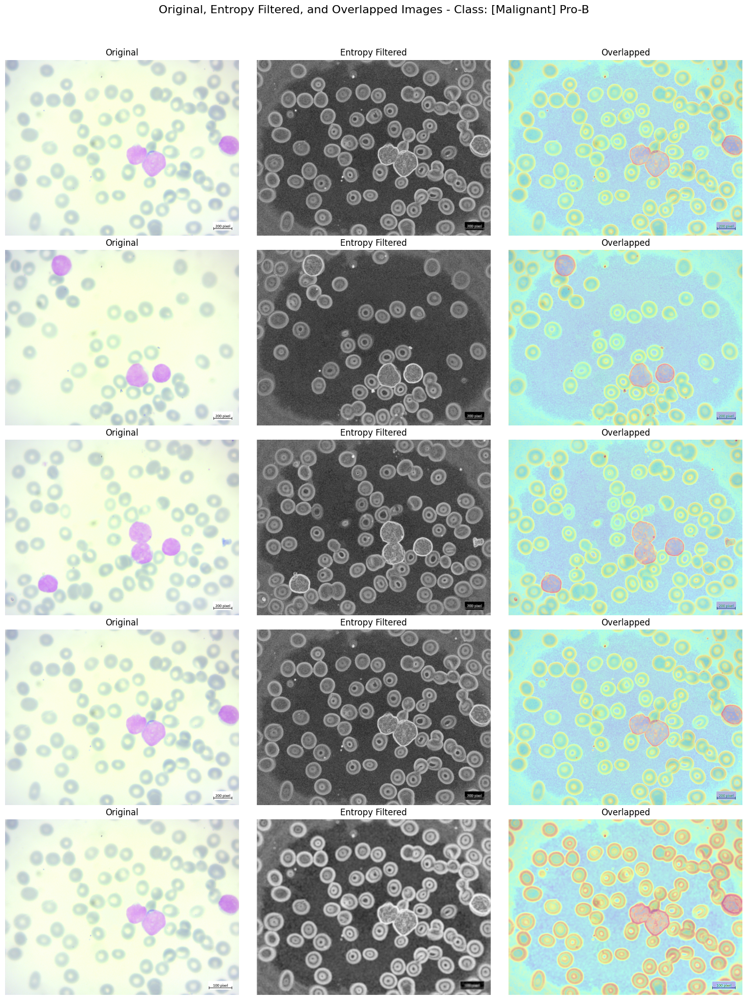

In [26]:
# visualization to overlapping of images
for cls in classes:
    class_path = os.path.join(dataset_path, cls)
    images = [os.path.join(class_path, img) for img in os.listdir(class_path) if img.endswith(('png', 'jpg', 'jpeg'))]

    # Select 5 images from each class
    selected_images = images[:5]

    fig, axes = plt.subplots(5, 3, figsize=(15, 20))
    fig.suptitle(f'Original, Entropy Filtered, and Overlapped Images - Class: {cls}', fontsize=16)

    for i, img_path in enumerate(selected_images):
        # Read and preprocess the image
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        filtered_image = apply_entropy_filtering(image, 5)

        # Normalize filtered image for blending
        filtered_image_normalized = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
        filtered_colored = cv2.applyColorMap(filtered_image_normalized, cv2.COLORMAP_JET)  # Apply color map
        filtered_colored = cv2.cvtColor(filtered_colored, cv2.COLOR_BGR2RGB)  # Convert to RGB for blending

        # Blend the original image with the colored entropy-filtered image
        overlapped_image = cv2.addWeighted(image, 0.7, filtered_colored, 0.3, 0)

        # Plot original image
        axes[i, 0].imshow(image)
        axes[i, 0].set_title('Original')
        axes[i, 0].axis('off')

        # Plot entropy filtered image
        axes[i, 1].imshow(filtered_image,  cmap='gray')
        axes[i, 1].set_title('Entropy Filtered')
        axes[i, 1].axis('off')

        # Plot overlapped image
        axes[i, 2].imshow(overlapped_image)
        axes[i, 2].set_title('Overlapped')
        axes[i, 2].axis('off')

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()
